In [25]:
from one.api import ONE
import numpy as np
import brainbox
import pandas as pd

In [172]:
#Load rasters

from one.api import ONE
one = ONE(base_url='https://openalyx.internationalbrainlab.org', password='international', silent=True)
eid = '58b1e920-cfc8-467e-b28b-7654a55d0977'
dsets = one.list_datasets(eid)
print(dsets)

['alf/_ibl_bodyCamera.dlc.pqt', 'alf/_ibl_bodyCamera.times.npy', 'alf/_ibl_leftCamera.dlc.pqt', 'alf/_ibl_leftCamera.features.pqt', 'alf/_ibl_leftCamera.times.npy', 'alf/_ibl_rightCamera.dlc.pqt', 'alf/_ibl_rightCamera.features.pqt', 'alf/_ibl_rightCamera.times.npy', 'alf/_ibl_trials.goCueTrigger_times.npy', 'alf/_ibl_trials.stimOff_times.npy', 'alf/_ibl_trials.table.pqt', 'alf/_ibl_wheel.position.npy', 'alf/_ibl_wheel.timestamps.npy', 'alf/_ibl_wheelMoves.intervals.npy', 'alf/_ibl_wheelMoves.peakAmplitude.npy', 'alf/bodyCamera.ROIMotionEnergy.npy', 'alf/bodyROIMotionEnergy.position.npy', 'alf/leftCamera.ROIMotionEnergy.npy', 'alf/leftROIMotionEnergy.position.npy', 'alf/licks.times.npy', 'alf/probe00/electrodeSites.brainLocationIds_ccf_2017.npy', 'alf/probe00/electrodeSites.localCoordinates.npy', 'alf/probe00/electrodeSites.mlapdv.npy', 'alf/probe00/pykilosort/_ibl_log.info_pykilosort.log', 'alf/probe00/pykilosort/_kilosort_whitening.matrix.npy', 'alf/probe00/pykilosort/_phy_spikes_sub

In [173]:
import re
for d in dsets:
    if re.search('_ibl_trials', d)!=None:
        print(d)

alf/_ibl_trials.goCueTrigger_times.npy
alf/_ibl_trials.stimOff_times.npy
alf/_ibl_trials.table.pqt


In [174]:
dat = one.load_dataset(eid, 'alf/_ibl_trials.table.pqt')
print(dat)

         feedback_times  choice  feedbackType  contrastLeft  rewardVolume  \
trial_#                                                                     
0             77.552936      -1             1           NaN           1.5   
1             82.317826      -1             1           NaN           1.5   
2             88.602187      -1            -1        0.0000           0.0   
3             97.802736      -1             1           NaN           1.5   
4            102.626654      -1             1           NaN           1.5   
...                 ...     ...           ...           ...           ...   
723         3536.388917       1             1        1.0000           1.5   
724         3555.066952      -1            -1        0.0000           0.0   
725         3605.015008      -1            -1        0.0625           0.0   
726         3657.927180      -1             1           NaN           1.5   
727         5088.099369       0            -1        0.0625           0.0   

In [175]:
df=pd.DataFrame(dat)
trials_=df.loc[(df['choice'] == 1) & (df['contrastLeft'] == 1.0)].index
print(trials)

<module 'brainbox.task.trials' from '/home/maria/anaconda3/lib/python3.7/site-packages/brainbox/task/trials.py'>


In [61]:
import re
for d in dsets:
    if re.search('spikes', d)!=None:
        print(d)

alf/probe00/pykilosort/_phy_spikes_subset.channels.npy
alf/probe00/pykilosort/_phy_spikes_subset.spikes.npy
alf/probe00/pykilosort/_phy_spikes_subset.waveforms.npy
alf/probe00/pykilosort/spikes.amps.npy
alf/probe00/pykilosort/spikes.clusters.npy
alf/probe00/pykilosort/spikes.depths.npy
alf/probe00/pykilosort/spikes.samples.npy
alf/probe00/pykilosort/spikes.templates.npy
alf/probe00/pykilosort/spikes.times.npy


In [62]:
spike_times=one.load_dataset(eid, 'alf/probe00/pykilosort/spikes.times.npy')
spike_amps=one.load_dataset(eid, 'alf/probe00/pykilosort/spikes.amps.npy')
spike_depths=one.load_dataset(eid, 'alf/probe00/pykilosort/spikes.depths.npy')
spike_clusters=one.load_dataset(eid, 'alf/probe00/pykilosort/spikes.clusters.npy')

/home/maria/Downloads/ONE/openalyx.internationalbrainlab.org/wittenlab/Subjects/ibl_witten_29/2021-06-19/001/alf/probe00/pykilosort/spikes.clusters.npy: 100%|██████████| 21.9M/21.9M [00:11<00:00, 1.91MB/s]


In [37]:
print(spike_amps)

[5.87848961e-05 9.12326623e-05 9.62825340e-05 ... 1.41512233e-04
 1.72180743e-04 9.82502480e-05]


In [35]:
import re
for d in dsets:
    if re.search('channels', d)!=None:
        print(d)

alf/probe00/pykilosort/_phy_spikes_subset.channels.npy
alf/probe00/pykilosort/channels.brainLocationIds_ccf_2017.npy
alf/probe00/pykilosort/channels.localCoordinates.npy
alf/probe00/pykilosort/channels.mlapdv.npy
alf/probe00/pykilosort/channels.rawInd.npy
alf/probe00/pykilosort/clusters.channels.npy
raw_ephys_data/_spikeglx_sync.channels.npy
raw_ephys_data/probe00/_spikeglx_sync.channels.probe00.npy


In [49]:
channels=one.load_dataset(eid, 'alf/probe00/pykilosort/clusters.channels.npy')
brain_areas=one.load_dataset(eid, 'channels.brainLocationIds_ccf_2017.npy')

In [55]:
channels

array([  0,   1,   1,   2,   3,   3,   3,   3,   3,   3,   3,   3,   3,
         3,   5,   7,   3,   3,   4,   6,   8,   9,   9,  11,  11,  12,
        14,  15,  15,  16,  18,  18,  18,  22,  19,  19,  19,  21,  23,
        24,  24,  25,  25,  25,  27,  27,  27,  29,  30,  30,  30,  30,
        31,  31,  32,  33,  33,  34,  32,  34,  34,  34,  35,  35,  38,
        38,  43,  45,  46,  46,  51,  63,  51,  57,  59,  63,  65,  65,
        69,  70,  70,  72,  73,  75,  74,  74,  76,  77,  78,  80,  82,
        82,  84,  85,  86,  86,  87,  87,  88,  88,  89,  91,  91,  91,
        91,  91,  91,  95,  95, 102, 102, 109, 114, 114, 114, 114, 114,
       114, 128, 114, 133, 134, 134, 138, 138, 151, 142, 146, 146, 150,
       153, 151, 151, 151, 151, 154, 154, 166, 166, 166, 191, 191, 191,
       220, 220, 237, 239, 239, 245, 249, 250, 250, 252, 254, 255, 255,
       254, 257, 258, 258, 259, 263, 263, 264, 264, 265, 266, 268, 268,
       269, 270, 270, 270, 269, 271, 269, 272, 272, 273, 274, 27

In [81]:
import re
for d in dsets:
    if re.search('clusters', d)!=None:
        print(d)

alf/probe00/pykilosort/clusters.amps.npy
alf/probe00/pykilosort/clusters.channels.npy
alf/probe00/pykilosort/clusters.depths.npy
alf/probe00/pykilosort/clusters.metrics.pqt
alf/probe00/pykilosort/clusters.peakToTrough.npy
alf/probe00/pykilosort/clusters.uuids.csv
alf/probe00/pykilosort/clusters.waveforms.npy
alf/probe00/pykilosort/clusters.waveformsChannels.npy
alf/probe00/pykilosort/spikes.clusters.npy


In [56]:
import numpy as np

# Load the channel numbers for each cluster
channels = one.load_dataset(eid, 'alf/probe00/pykilosort/clusters.channels.npy')

# Load the brain area for each channel
brain_areas = one.load_dataset(eid, 'channels.brainLocationIds_ccf_2017.npy')

# Use numpy.take() to select the corresponding brain area for each channel in the clusters.channels file
cluster_brain_areas = np.take(brain_areas, channels)

In [57]:
print(cluster_brain_areas)

[ 313  313  313  313  313  313  313  313  313  313  313  313  313  313
  313  313  313  313  313  313  313  313  313  874  874  874  874  874
  874  874  874  874  874  874  874  874  874  874  874  874  874  874
  874  874  874  874  874  874  874  874  874  874  874  874  874  874
  874  874  874  874  874  874  874  874  874  874  313  313  313  313
  313  313  313  313  313  313  313  313  313  313  313  313  313  313
  313  313  313  313  313  313  313  313  313  313  313  313  313  313
  482  482  482  482  482  482  482  482  482  482  482  482  482  482
  482  482  482  482  482  482 1084  482 1084 1084 1084 1037 1037 1037
 1037 1037 1037 1037 1037 1037 1037 1037 1037 1037 1037 1037 1037 1037
 1037 1037 1037  971  971   33   33   33   33   33   33   33   33   33
   33   33   33  778  778  778  778  778  778  778  778  778  778  778
  778  778  778  778  778  778  778  778  778  778  778  778  778  721
  778  721  721  721  721  721  821  821  821  821  821  821  821  821
  821 

In [59]:
from ibllib.atlas.regions import BrainRegions

br = BrainRegions() 
for j in list(np.unique(cluster_brain_areas)):
    print(br.id2acronym(j , mapping='Allen-lr'))

['void']
['VISp6a']
['MB']
['bic']
['VISp1']
['VISp4']
['VISp5']
['VISp2/3']
['PBG']
['fp']
['POST']
['PRE']


In [65]:
# Create the raster with a bin size of 0.01 seconds
binsize = 0.1
#raster = brainbox.raster.create_time_raster(spike_times, spike_clusters, binsize)

#psth=get_psth(raster, trial_ids=trials)
# Filter the raster by the cluster ids you want
#cluster_ids = [1,2,3,4,5]
#raster = bb.raster.filter_raster_by_cluster_ids(raster, cluster_ids)

In [99]:
#https://int-brain-lab.github.io/iblenv/_autosummary/brainbox.task.trials.html
events=df["stimOn_times"]
from brainbox.task import trials
raster=trials.get_event_aligned_raster(spike_times, events, tbin=0.02, values=None, epoch=[-0.4, 1], bin=True)



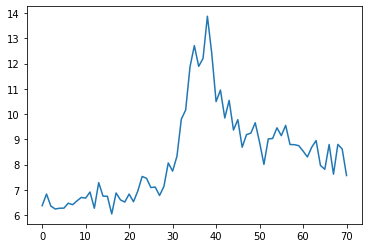

In [110]:
import matplotlib.pyplot as plt

plt.plot(np.std(raster[0],axis=0))

In [146]:
neuron_0=np.where(spike_clusters==313)
#raster=trials.get_event_aligned_raster(spike_times[neuron_0], events, tbin=0.02, values=None, epoch=[-0.4, 1], bin=True)

In [147]:
print(spike_clusters)
print(neuron_0)

[167 103  14 ...  24  15  93]
(array([], dtype=int64),)


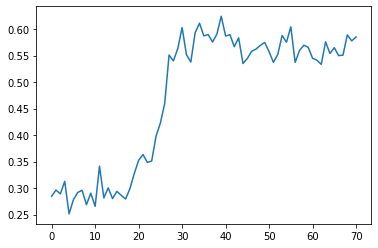

In [126]:
import matplotlib.pyplot as plt

plt.plot(np.std(raster[0],axis=0))

In [163]:
raster_dict={}
for n in list(np.unique(spike_clusters)):
    neuron=np.where(spike_clusters==n)
    if len(list(neuron[0]))!=0:
        print(len(list(neuron[0])))
        raster=trials.get_event_aligned_raster(spike_times[neuron], events, tbin=0.02, values=None, epoch=[-0.4, 1], bin=True)
        if np.isnan(raster[0]).any()==False:
            raster_dict[n]=raster[0]

187236
684
23337
146283
21527
18535
18966
13407
10646
24314
18122
17548
18125
4211
29632
109653
93
157
15250
36691
5637
16119
169403
2306
159709
16780
5985
15636
62
120099
3161
2273
9880
8680
10295
11
176
4803
46
1093
1283
6256
986
5749
94
28410
439
28445
11499
25179
7946
4962
4488
5415
1691
8885
175
46572
22158
7927
7024
10038
32506
3626
8372
12818
20
3317
2295
12419
1800
26972
1208
19154
16171
63154
12358
370
15706
65789
58576
103624
54746
19739
29961
62723
114953
18351
40609
36
1006
1483
19434
56353
29508
32982
16436
4399
13
281
27918
11
99
8037
5071
8020
2830
258
33464
130436
404
108
30025
57951
85096
1162
1369
42729
12112
11136
16537
25591
9988
7421
17104
10061
1738
14977
23722
31588
10121
15292
15764
1085
9877
13370
3497
1250
1638
2578
1470
8337
1264
1537
1162
104494
1460
1252
11457
6996
60250
24977
31180
28416
18423
28679
26325
20974
49398
3603
25306
10071
392
3951
6391
15039
20291
79106
44513
31671
1987
4319
700
49089
751
41475
1232
1545
46602
5895
775
50067
8430
66320
728
1511

In [137]:
print(spike_clusters)
print(cluster_brain_areas.shape)

[167 103  14 ...  24  15  93]
(298,)


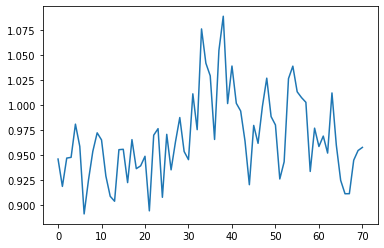

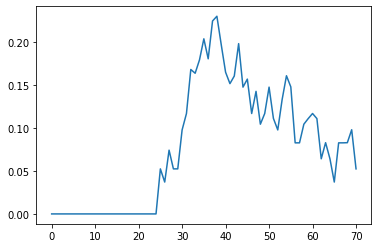

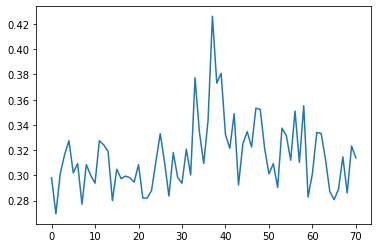

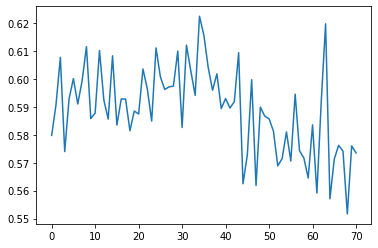

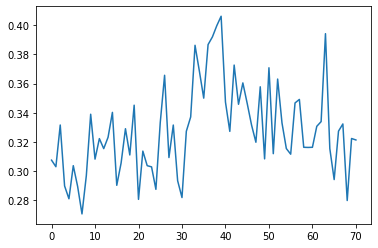

...

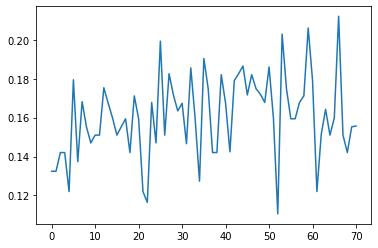

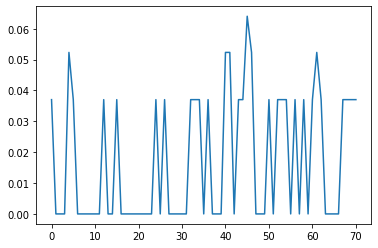

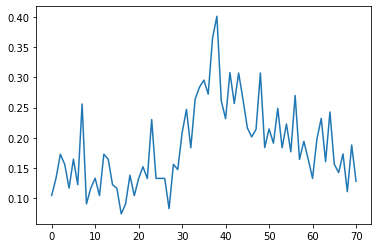

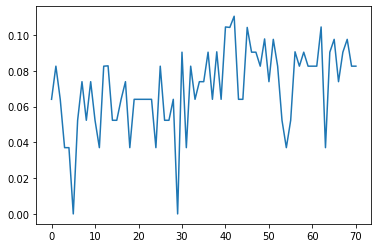

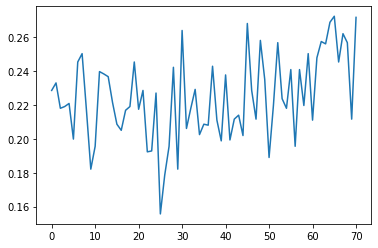

In [164]:
for k in raster_dict.keys():
    plt.plot(np.std(raster_dict[k],axis=0))
    plt.show()
   

In [202]:
psth_dict={}
print(list(trials_))
from brainbox.task import trials
for n in raster_dict.keys():
    psth=trials.get_psth(raster_dict[k],trial_ids=trials_)
    psth_dict[n]=psth



[14, 23, 24, 39, 42, 50, 68, 72, 74, 76, 94, 98, 104, 109, 110, 114, 118, 122, 129, 137, 143, 161, 181, 204, 235, 242, 246, 254, 260, 262, 269, 276, 280, 286, 291, 295, 299, 303, 304, 306, 311, 349, 367, 373, 378, 387, 388, 392, 396, 399, 408, 412, 415, 416, 449, 450, 475, 498, 500, 503, 511, 513, 528, 559, 603, 609, 610, 624, 639, 651, 673, 681, 694, 719, 723]


In [191]:
print(psth_dict[0])

(array([0.84      , 0.61333333, 0.96      , 0.6       , 0.69333333,
       0.88      , 0.76      , 0.69333333, 0.77333333, 0.69333333,
       0.73333333, 0.64      , 0.73333333, 0.81333333, 0.88      ,
       0.62666667, 0.84      , 0.77333333, 0.62666667, 0.88      ,
       0.85333333, 0.69333333, 0.70666667, 0.70666667, 0.76      ,
       0.82666667, 0.76      , 0.82666667, 0.66666667, 1.05333333,
       0.81333333, 0.68      , 0.92      , 0.78666667, 1.02666667,
       0.85333333, 0.82666667, 0.98666667, 1.05333333, 0.96      ,
       0.94666667, 0.86666667, 0.8       , 0.8       , 0.90666667,
       0.97333333, 0.58666667, 0.92      , 0.96      , 0.77333333,
       0.89333333, 0.69333333, 0.65333333, 0.90666667, 0.97333333,
       0.92      , 0.82666667, 0.90666667, 0.64      , 0.61333333,
       0.82666667, 0.8       , 0.8       , 0.69333333, 0.78666667,
       0.76      , 0.69333333, 0.77333333, 0.86666667, 0.69333333,
       0.6       ]), array([0.11629847, 0.09778586, 0.1169083

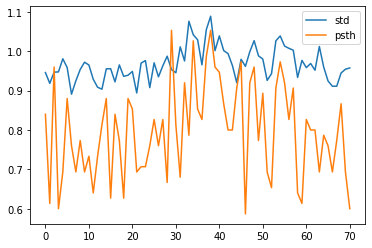

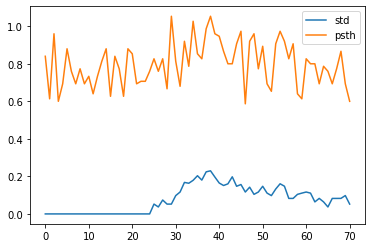

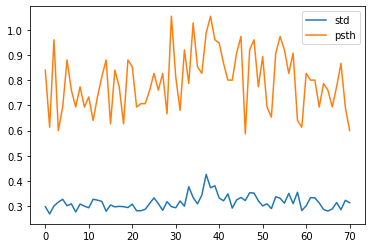

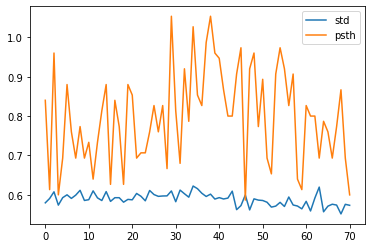

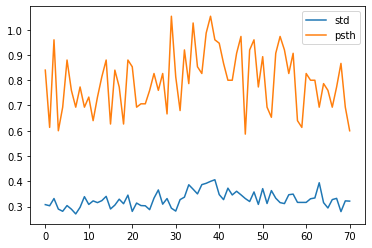

...

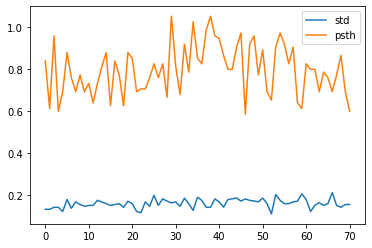

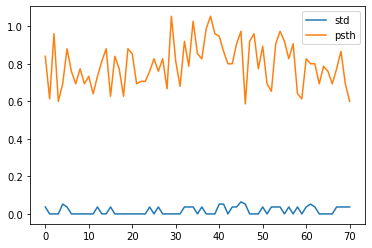

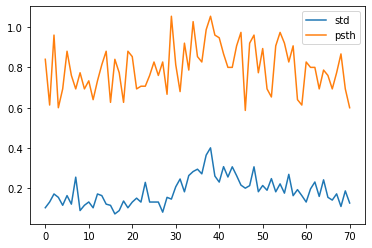

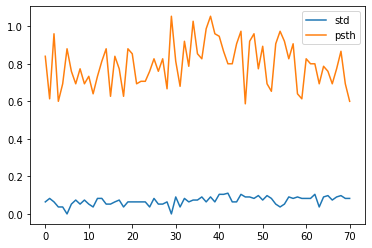

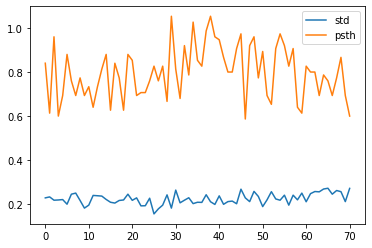

In [195]:
for k in raster_dict.keys():
    plt.plot(np.std(raster_dict[k],axis=0))
    plt.plot(psth_dict[k][0])
    plt.legend(["std","psth"])
    plt.show()

In [198]:
psth.keys()

AttributeError: 'tuple' object has no attribute 'keys'

In [205]:
#normalize rasters and take psth
fluctuations_dict={}
for n in raster_dict.keys():
    sub=raster_dict[n]-psth_dict[n][0]
    fluctuations=np.std(sub,axis=0)
    fluctuations_dict[n]=fluctuations

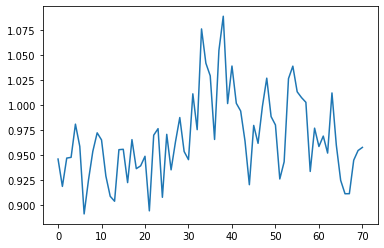

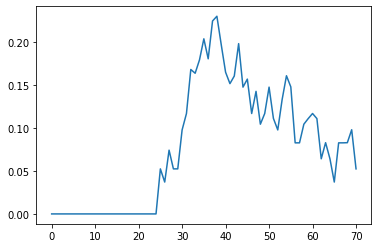

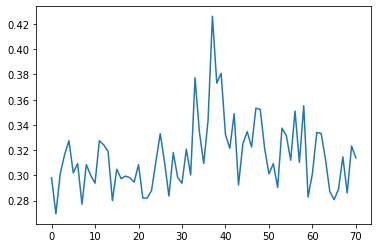

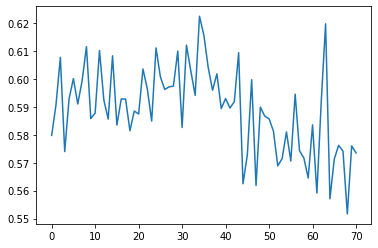

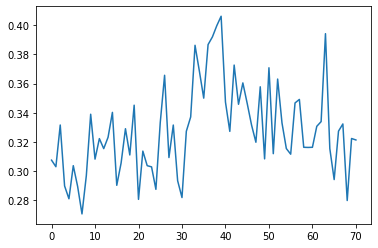

...

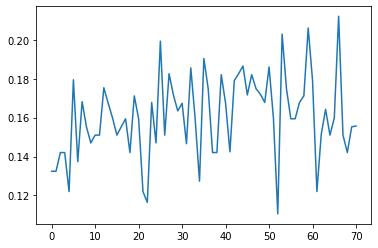

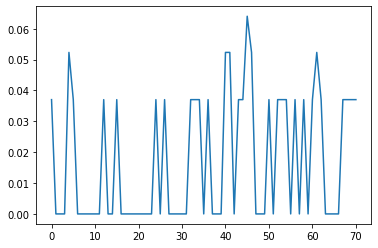

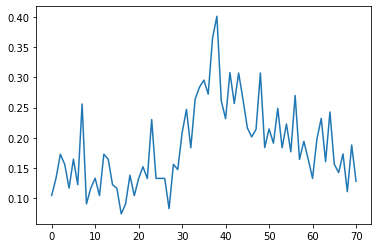

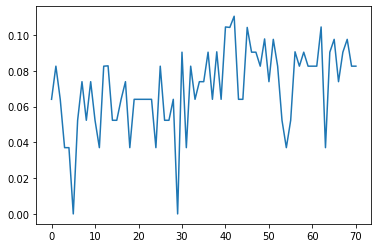

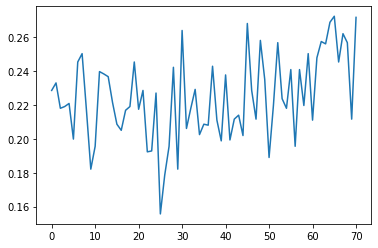

In [206]:
for k in fluctuations_dict.keys():
    plt.plot(fluctuations_dict[k])
    plt.show()